In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

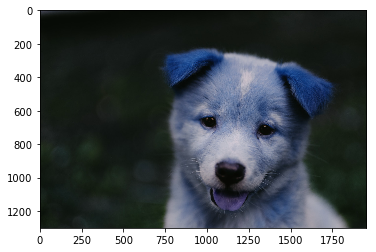

In [11]:
img = cv2.imread('../DATA/00-puppy.jpg')
plt.imshow(img)

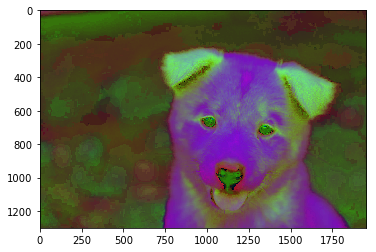

In [10]:
img = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
plt.imshow(img)

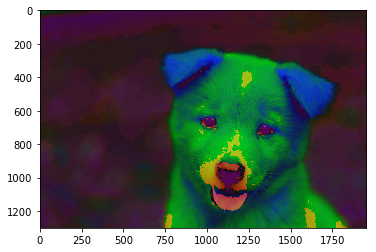

In [12]:
img = cv2.cvtColor(img,cv2.COLOR_BGR2HLS)
plt.imshow(img)

Blending and pasting images

In [18]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [16]:
img1 = cv2.imread('../DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

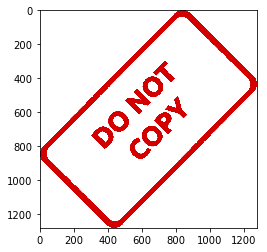

In [20]:
plt.imshow(img2)

In [21]:
img1.shape

(1401, 934, 3)

In [22]:
img2.shape

(1280, 1277, 3)

In [23]:
#BLENDING IMAGES OF THE SAME SIZE
img1 = cv2.resize(img1,(1200,1200))
img2 = cv2.resize(img2,(1200,1200))

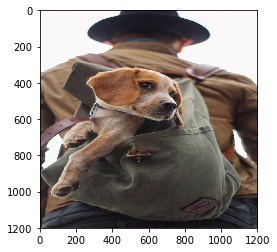

In [24]:
plt.imshow(img1)

In [47]:
blended = cv2.addWeighted(src1=img1, alpha=0.9, src2=img2, beta=0.2, gamma=0.5)

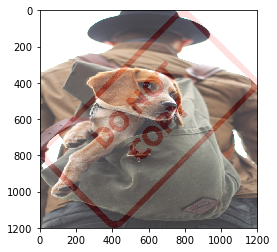

In [48]:
plt.imshow(blended)

In [49]:
#OVERLAY SMALLER IMAGE ON TOP OF LARGER IMAGE. NO BLENDING. YOU DO NOT SEE ORIGINAL IMAGE UNDERNEATH
#NUMPY REASSIGMMENT

In [72]:
img1 = cv2.imread('../DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

In [73]:
img2 = cv2.resize(img2, (600, 600))

In [74]:
large_img = img1
small_img = img2

In [75]:
X_offset = 50
Y_offset = 50
X_end = X_offset + small_img.shape[1]
Y_end = Y_offset + small_img.shape[0]

In [76]:
#in numpy the x values are columns and y values are rows
large_img[Y_offset:Y_end, X_offset:X_end] = small_img

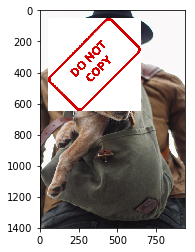

In [77]:
plt.imshow(large_img)

In [78]:
# BLEND TOGETHER IMAGES OF DIFFERENT SIZES

In [120]:
img1 = cv2.imread('../DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)


In [121]:
img2 = cv2.resize(img2, (600, 600))

In [81]:
img1.shape

(1401, 934, 3)

In [123]:
#y axis is 1401 and X is 934
X_offset = 943 - 600
Y_offset = 1401 - 600
X_offset = img1.shape[1] - img2.shape[1]
Y_offset = img1.shape[0] - img2.shape[0]


In [124]:
Y_offset

801

In [125]:
rows, columns, channels = img2.shape

In [126]:
type(img1.shape[0])

int

In [131]:
roi = img1[Y_offset:img1.shape[0], X_offset:img1.shape[1]]

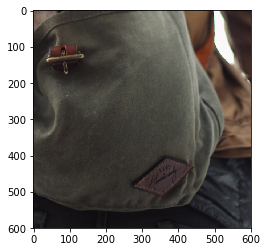

In [132]:
plt.imshow(roi)

In [133]:
img2_gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

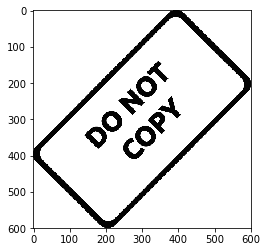

In [134]:
plt.imshow(img2_gray, cmap='gray')

In [108]:
mask_inv = cv2.bitwise_not(img2_gray)

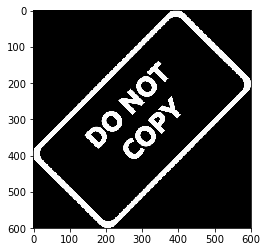

In [109]:
plt.imshow(mask_inv, cmap='gray')

In [111]:
mask_inv.shape
#no colorchannels!

(600, 600)

In [115]:
white_background = np.full(img2.shape, 255, dtype=np.uint8)

In [116]:
white_background.shape

(600, 600, 3)

In [117]:
background = cv2.bitwise_or(white_background, white_background, mask=mask_inv)

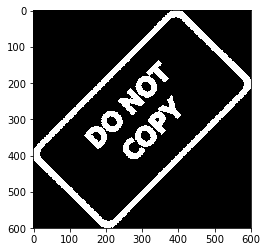

In [135]:
plt.imshow(background)


In [1]:
#Thresholding

In [2]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [7]:
img = cv2.imread('../DATA/rainbow.jpg', flags=0)

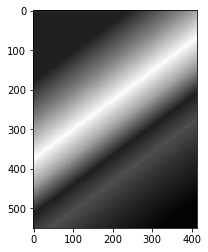

In [9]:
plt.imshow(img, cmap='gray')

In [22]:
ret, img2 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

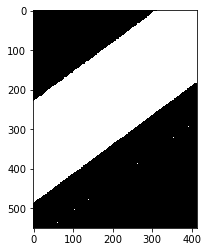

In [24]:
plt.imshow(img2, cmap='gray')

In [25]:
ret #cut off value

127.0

In [26]:
ret, img2 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY_INV)

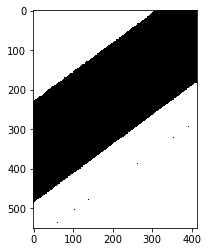

In [27]:
plt.imshow(img2, cmap='gray')

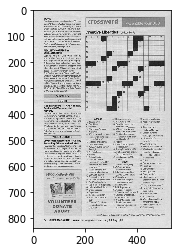

In [30]:
img = cv2.imread('../DATA/crossword.jpg',0)
plt.imshow(img, cmap='gray')

In [31]:
def show_pic(img):
    fg = plt.figure(figsize=(15, 15))
    ax = fg.add_subplot(111)
    ax.imshow(img, cmap='gray')

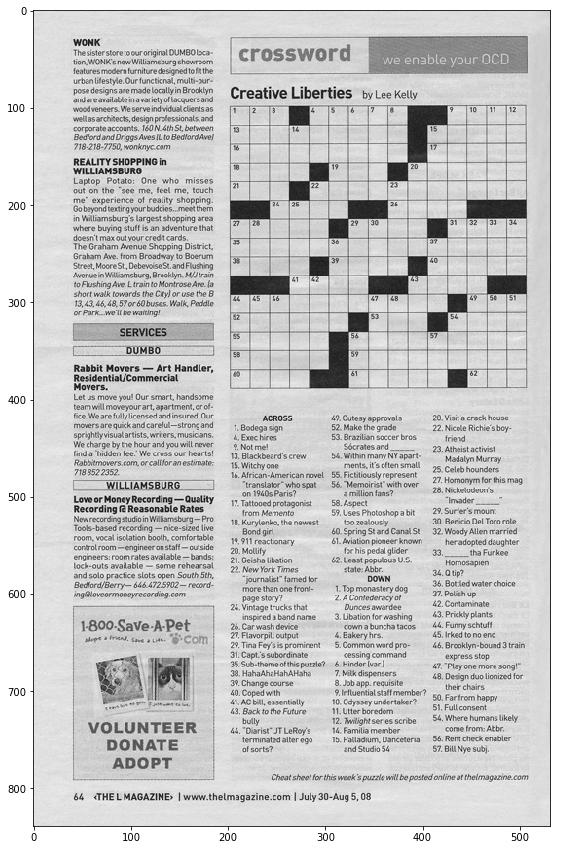

In [32]:
show_pic(img)

In [40]:
ret, img = cv2.threshold(img, 155, 255, cv2.THRESH_BINARY)

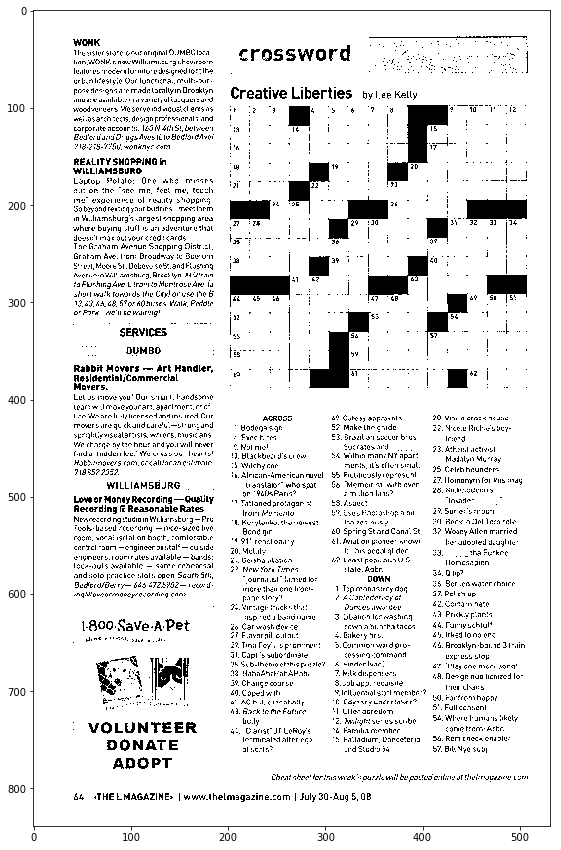

In [41]:
show_pic(img)

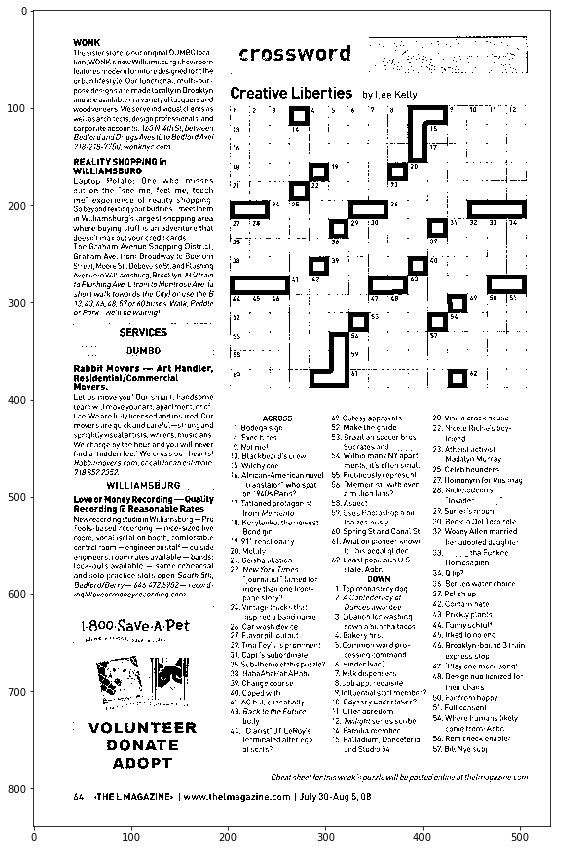

In [61]:
#adaptive threshold
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 8) # Play around with these last 2 numbers
show_pic(th2)

In [62]:
#blend the adaptive image with the binary img
blended = cv2.addWeighted(src1=img, alpha=0.6, src2=th2, beta=0.4, gamma=0 )

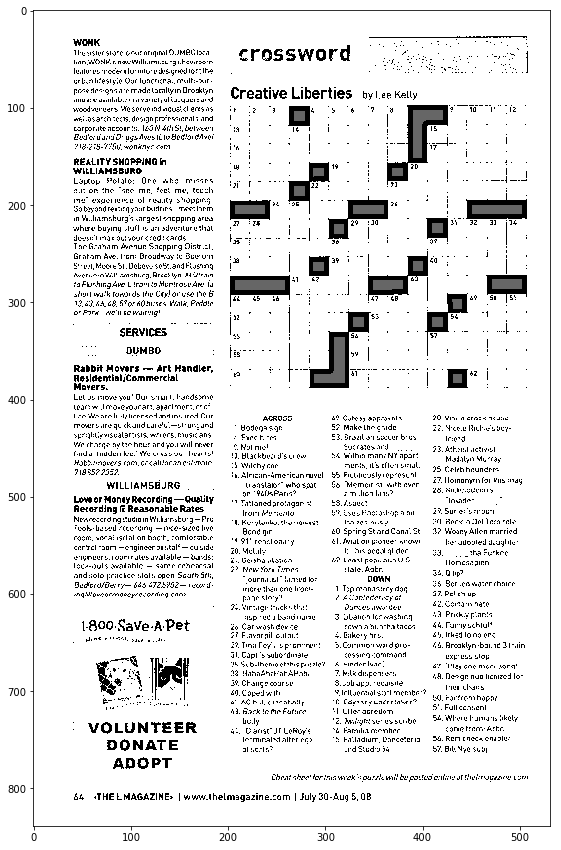

In [63]:
show_pic(blended)

In [64]:
#blurring and smoothing (edge detection)
#by using kernels https://setosa.io/ev/image-kernels/

In [77]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [78]:
def load_img():
    img=cv2.imread('../DATA/bricks.jpg').astype(np.float32) / 255
    img =cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img


def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img)

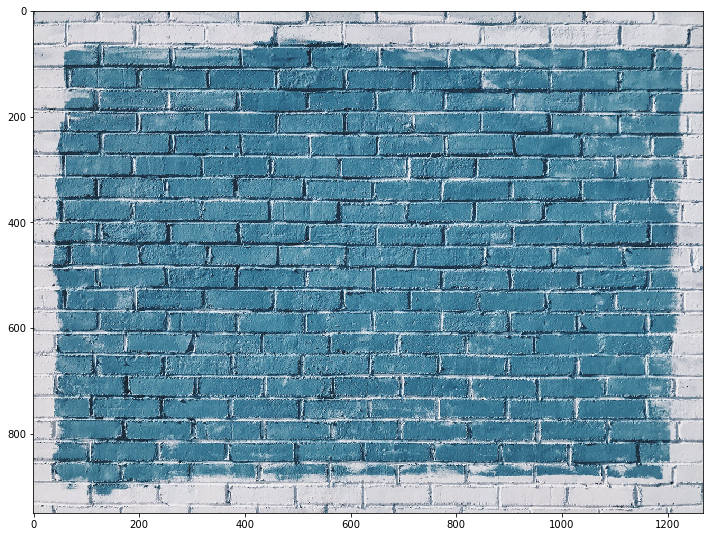

In [79]:
i = load_img()
display_img(i)

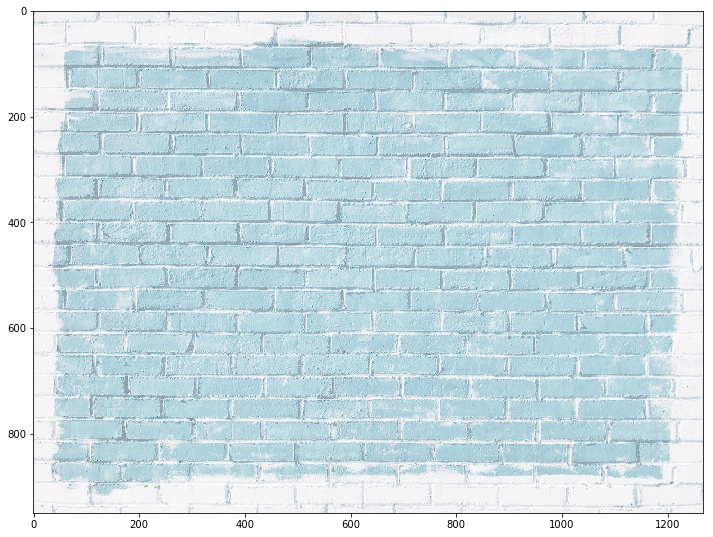

In [85]:
# gamma = 2
gamma = 1/4
result = np.power(i, gamma)
display_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


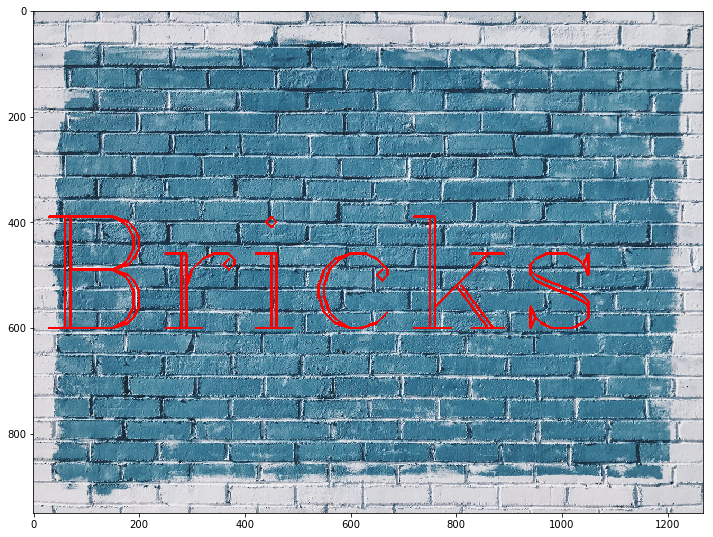

In [88]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks', org=(10,600), fontFace=font, fontScale=10, color=(255, 0, 0), thickness=4)
display_img(img)

In [175]:
kernel = np.ones(shape=(5,5), dtype=np.float32)/25

In [176]:
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

In [182]:
dst = cv2.filter2D(img, -1, kernel)

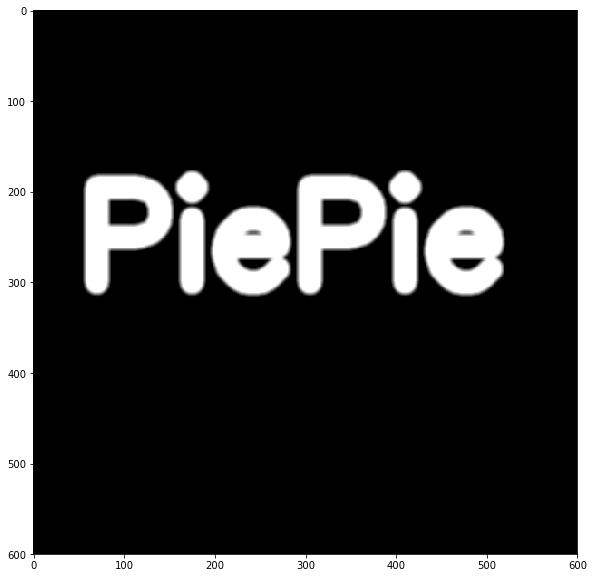

In [183]:
display_img(dst)

In [140]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks', org=(10,600), fontFace=font, fontScale=10, color=(255, 0, 0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


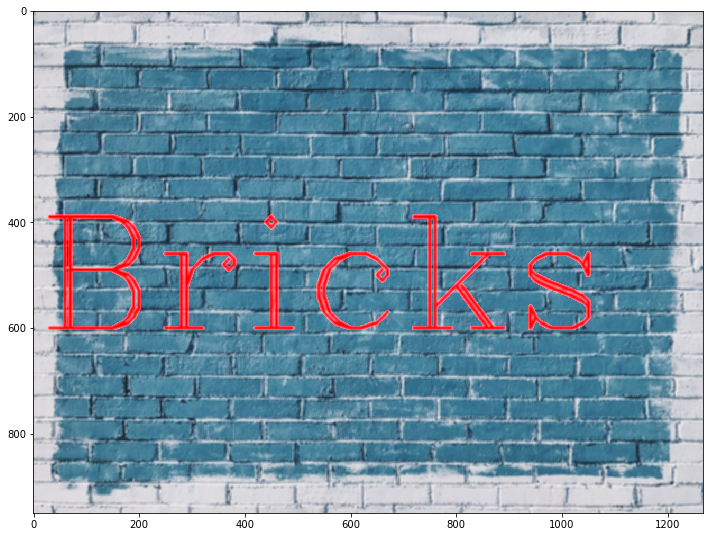

In [141]:
blurred = cv2.blur(img, ksize=(5,5))
display_img(blurred)

In [147]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks', org=(10,600), fontFace=font, fontScale=10, color=(255, 0, 0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


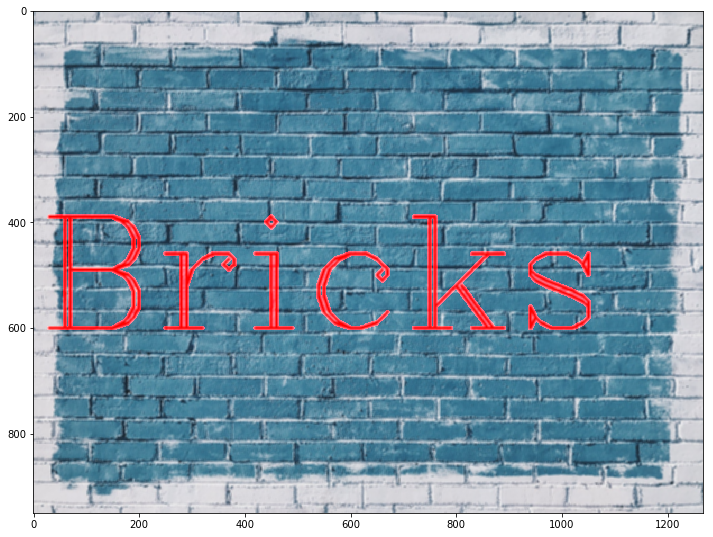

In [148]:
blurred_img = cv2.GaussianBlur(img, ksize=(5,5),sigmaX=10)
display_img(blurred_img)

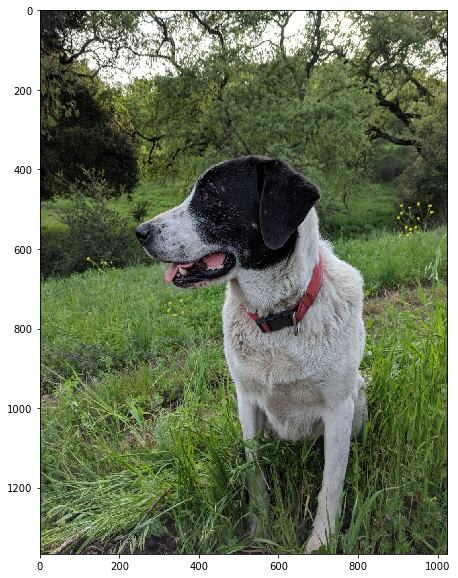

In [150]:
img = cv2.imread('../DATA/sammy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
display_img(img)

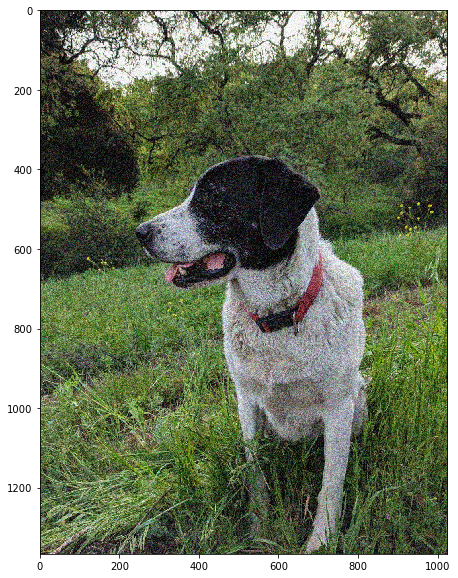

In [151]:
noise_img = cv2.imread('../DATA/sammy_noise.jpg')
display_img(noise_img)

In [152]:
median = cv2.medianBlur(noise_img, 5)

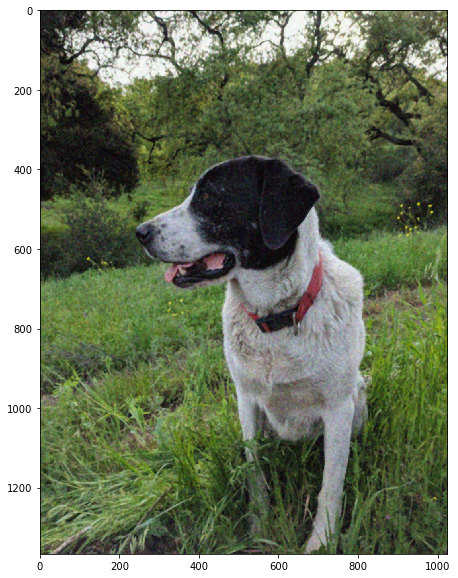

In [153]:
display_img(median)

In [154]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks', org=(10,600), fontFace=font, fontScale=10, color=(255, 0, 0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


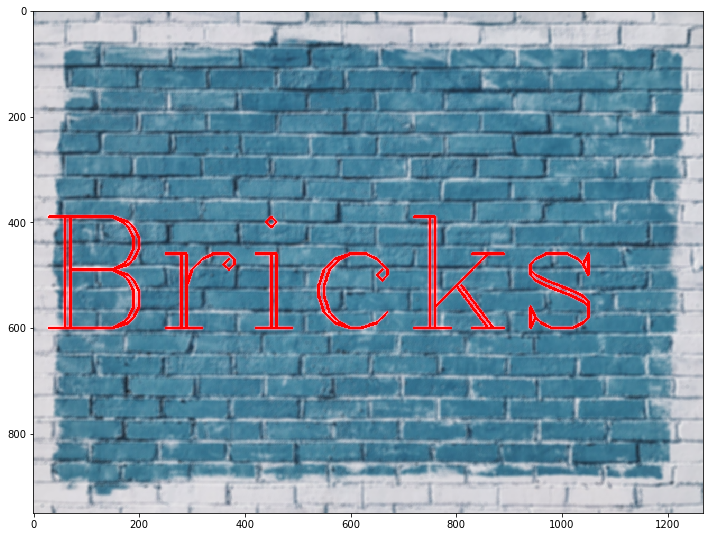

In [155]:
blur = cv2.bilateralFilter(img, 9, 75, 75)
display_img(blur)

In [1]:
#morphological operators (for text, reduces black spots)
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
def load_img():
    blank_img = np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img, text='PiePie',org=(50,300),fontFace=font,fontScale=5,color=(255,255,255),thickness=25)
    return blank_img


def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap='gray')

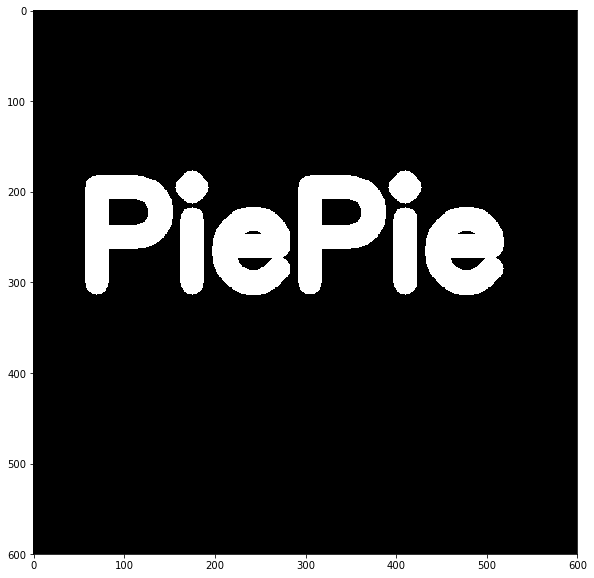

In [3]:
img = load_img()
display_img(img)

In [4]:
kernel = np.ones((5,5), dtype=(np.uint8)) * 255
kernel

array([[255, 255, 255, 255, 255],
       [255, 255, 255, 255, 255],
       [255, 255, 255, 255, 255],
       [255, 255, 255, 255, 255],
       [255, 255, 255, 255, 255]], dtype=uint8)

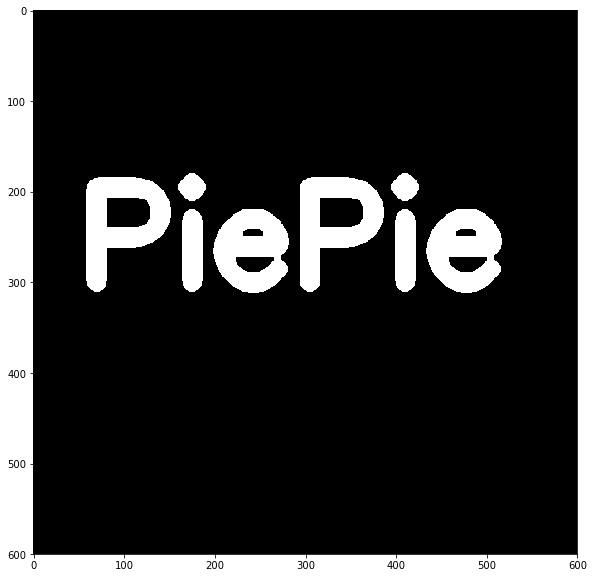

In [5]:
result = cv2.erode(img, kernel, iterations=1)
display_img(result)

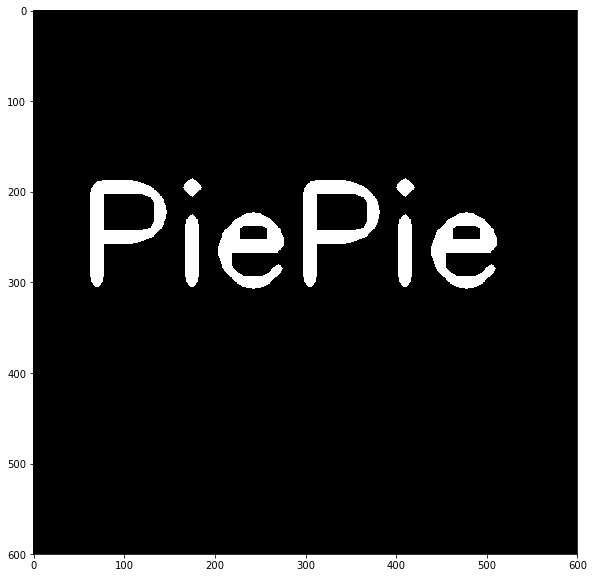

In [6]:
    result = cv2.erode(img, kernel, iterations=3)
display_img(result)

In [7]:
img = load_img()

In [8]:
white_noise = np.random.randint(low=0, high=2, size=(600,600))

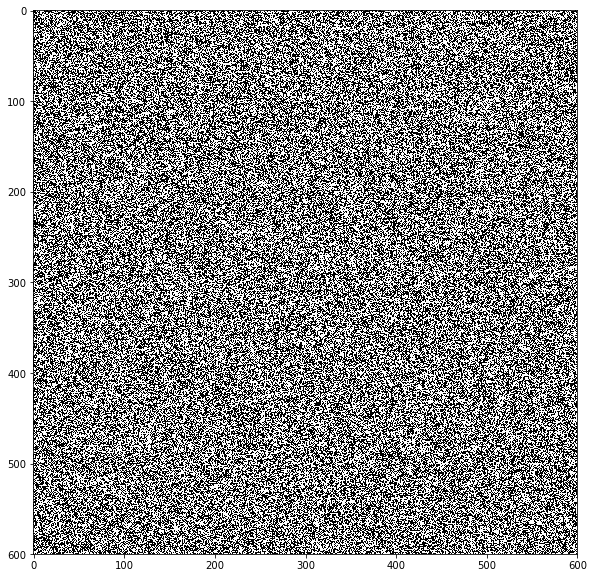

In [9]:
display_img(white_noise)

In [10]:
img.max() 

255.0

In [11]:
white_noise.max()

1

In [12]:
white_noise = white_noise * 255

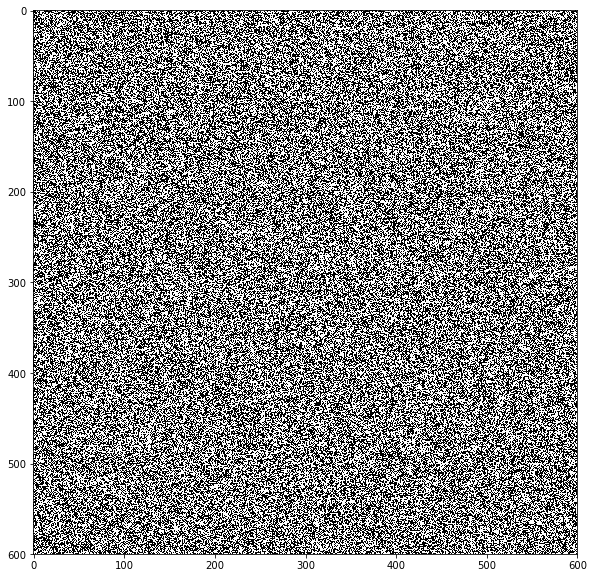

In [13]:
display_img(white_noise)

In [14]:
noisey = white_noise + img

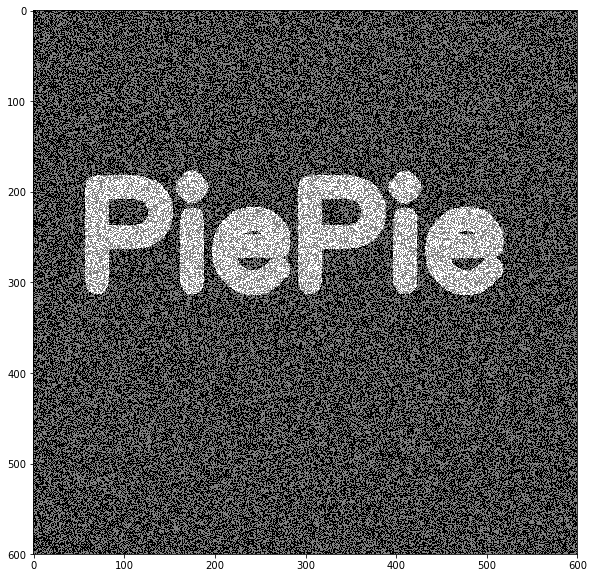

In [15]:
display_img(noisey)

In [16]:
opening = cv2.morphologyEx(noisey, cv2.MORPH_OPEN, kernel)

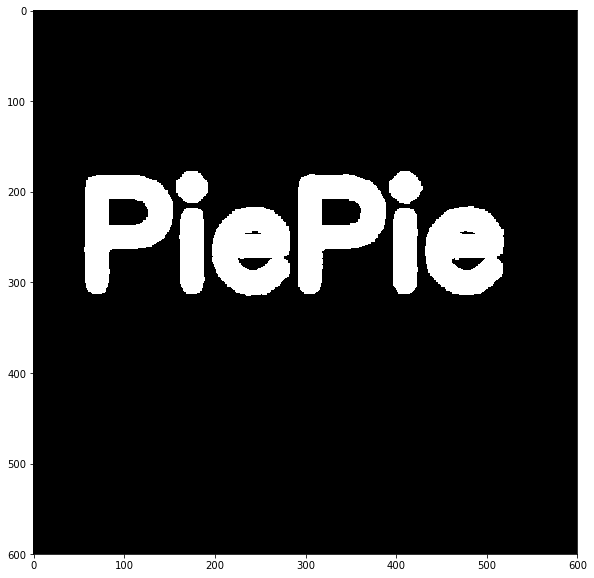

In [17]:
display_img(opening)

In [18]:
#image with forground noise (black noise)
img = load_img()

In [21]:
black_noise = np.random.randint(low=0, high=2, size=(600,600))

In [22]:
black_noise

array([[1, 1, 0, ..., 1, 0, 1],
       [1, 1, 1, ..., 1, 0, 0],
       [1, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 1, ..., 0, 0, 1],
       [0, 0, 1, ..., 0, 1, 1],
       [1, 0, 1, ..., 1, 1, 0]])

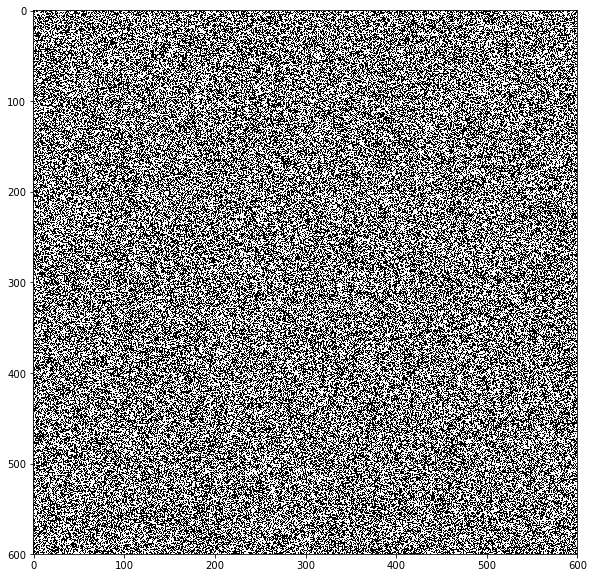

In [20]:
display_img(black_noise)

In [23]:
black_noise = black_noise * -255

In [24]:
black_noise

array([[-255, -255,    0, ..., -255,    0, -255],
       [-255, -255, -255, ..., -255,    0,    0],
       [-255,    0, -255, ...,    0, -255, -255],
       ...,
       [   0,    0, -255, ...,    0,    0, -255],
       [   0,    0, -255, ...,    0, -255, -255],
       [-255,    0, -255, ..., -255, -255,    0]])

In [25]:
black_noise_img = img + black_noise

In [27]:
black_noise_img

array([[-255., -255.,    0., ..., -255.,    0., -255.],
       [-255., -255., -255., ..., -255.,    0.,    0.],
       [-255.,    0., -255., ...,    0., -255., -255.],
       ...,
       [   0.,    0., -255., ...,    0.,    0., -255.],
       [   0.,    0., -255., ...,    0., -255., -255.],
       [-255.,    0., -255., ..., -255., -255.,    0.]])

In [28]:
black_noise_img[black_noise_img == -255] = 0

In [29]:
black_noise_img

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

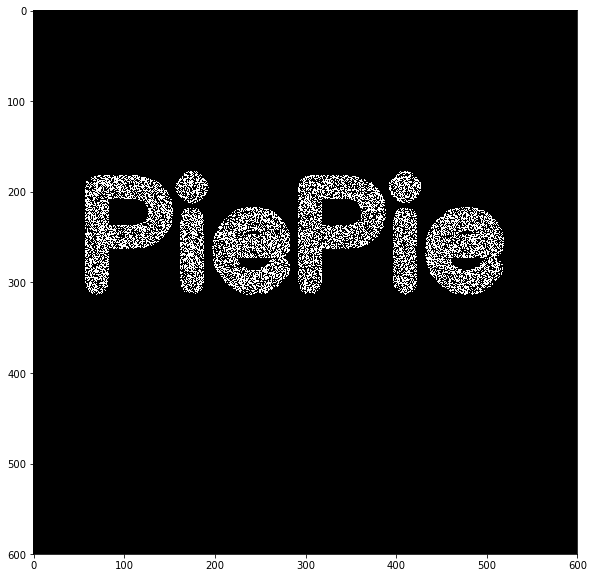

In [30]:
display_img(black_noise_img)

In [32]:
closing = cv2.morphologyEx(black_noise_img, op=cv2.MORPH_CLOSE, kernel=kernel)

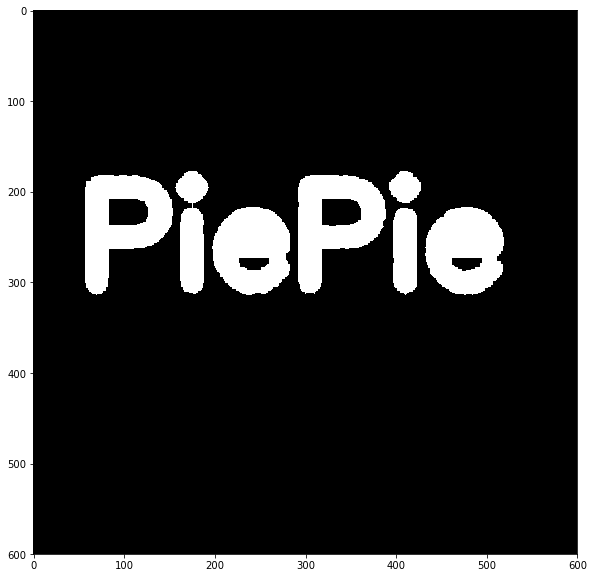

In [34]:
display_img(closing)

In [35]:
img = load_img()

In [36]:
gradient = cv2.morphologyEx(src=img, op=cv2.MORPH_GRADIENT, kernel=kernel)

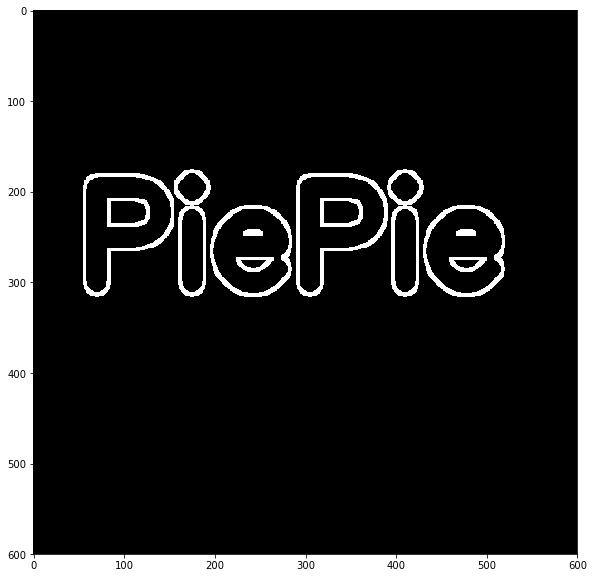

In [37]:
display_img(gradient)